**New Code**


----------------------------------------------------------New


In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [2]:
labels_json_path = "/content/drive/MyDrive/SomeOtherFolder/labels_list.json"

In [3]:
!pip install torch torchvision

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 4.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.8/13.8 MB 121.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.6/24.6 MB 99.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 883.7/883.7 kB 66.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 2.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 5.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 12.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 127.9/127.9 MB 7.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.5/207.5 MB 5.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.1/21.1 MB 83.4 MB/s eta 0:00:00
  Attempting uninstall: nvidia-nvjitlink-cu12
    Found existing installation: nvidia-nvjitlink-cu12 12.5.82
    Uninstalling nvidia-nvjitlink-cu12-12.5.82:
      Successfully uninstalled nvidia-nvjitli

In [4]:
from torchvision.datasets import ImageFolder
import torchvision.transforms as transforms
import numpy as np

# Define the preprocessing transforms (as in your previous code)
mean_norms = np.array([0.485, 0.456, 0.406])
std_norms = np.array([0.229, 0.224, 0.225])
plain_transforms = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize(mean=mean_norms, std=std_norms)
])

# Load the dataset
dataset_path = "/content/drive/MyDrive/TestDataSet"
dataset = ImageFolder(root=dataset_path, transform=plain_transforms)

In [5]:
   import os
   print(os.listdir("/content/drive/MyDrive/TestDataSet"))

['labels_list.json', '.DS_Store', 'n03014705', 'n03017168', 'n03000684', 'n03032252', 'n03042490', 'n03018349', 'n03026506', 'n03041632', 'n03016953', 'n03028079', 'n02979186', 'n02999410', 'n02988304', 'n02978881', 'n02980441', 'n02981792', 'n03000134', 'n02992529', 'n02992211', 'n03000247', 'n02966193', 'n02977058', 'n02966687', 'n02974003', 'n02963159', 'n02965783', 'n02950826', 'n02951358', 'n02951585', 'n02971356', 'n02948072', 'n02906734', 'n02939185', 'n02917067', 'n02930766', 'n02895154', 'n02910353', 'n02909870', 'n02916936', 'n02927161', 'n02892201', 'n02877765', 'n02892767', 'n02865351', 'n02869837', 'n02879718', 'n02883205', 'n02894605', 'n02871525', 'n02870880', 'n02835271', 'n02837789', 'n02843684', 'n02860847', 'n02825657', 'n02841315', 'n02834397', 'n02823750', 'n02840245', 'n02859443', 'n02808440', 'n02804414', 'n02817516', 'n02823428', 'n02804610', 'n02808304', 'n02814533', 'n02815834', 'n02814860', 'n02807133', 'n02797295', 'n02791270', 'n02795169', 'n02791124', 'n02

In [6]:
import json
import re

labels_json_path = "/content/drive/MyDrive/TestDataSet/labels_list.json"
with open(labels_json_path, "r") as f:
    label_entries = json.load(f)

# Build a list of class names in the same order as your dataset
class_names = []
for entry in label_entries:
    match = re.match(r"\d+: (.+)", entry)
    if match:
        class_names.append(match.group(1).strip())

print(class_names[:10])

['accordion', 'acoustic guitar', 'aircraft carrier', 'airliner', 'airship', 'altar', 'ambulance', 'amphibian', 'analog clock', 'apiary']


In [7]:
# dataset.classes gives you the WNIDs in the same order as your dataset
wnids = dataset.classes

# Now, build a mapping from WNID to class name
wnid_to_class = {wnid: class_name for wnid, class_name in zip(wnids, class_names)}
class_to_idx = {class_name: idx for idx, class_name in enumerate(class_names)}

print(list(wnid_to_class.items())[:5])

[('n02672831', 'accordion'), ('n02676566', 'acoustic guitar'), ('n02687172', 'aircraft carrier'), ('n02690373', 'airliner'), ('n02692877', 'airship')]


In [8]:
# dataset.classes gives you the WNIDs in the same order as your dataset
wnids = dataset.classes  # e.g., ['n02672831', 'n02676566', ...]

# Now, build a mapping from WNID to class name
wnid_to_class = {wnid: class_name for wnid, class_name in zip(wnids, class_names)}
class_to_idx = {class_name: idx for idx, class_name in enumerate(class_names)}

print(list(wnid_to_class.items())[:5])

[('n02672831', 'accordion'), ('n02676566', 'acoustic guitar'), ('n02687172', 'aircraft carrier'), ('n02690373', 'airliner'), ('n02692877', 'airship')]


In [9]:
from torch.utils.data import DataLoader

# Assuming you already loaded 'dataset' as shown previously
test_loader = DataLoader(dataset, batch_size=32, shuffle=False)

In [10]:
import torch
import torchvision
import torchvision.transforms as transforms
import torch.nn.functional as F
import numpy as np
import json
import re
from torch.utils.data import DataLoader

# 1. Set device
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

# 2. Load dataset
mean_norms = np.array([0.485, 0.456, 0.406])
std_norms = np.array([0.229, 0.224, 0.225])
plain_transforms = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize(mean=mean_norms, std=std_norms)
])
dataset_path = "/content/drive/MyDrive/TestDataSet"
dataset = torchvision.datasets.ImageFolder(root=dataset_path, transform=plain_transforms)
test_loader = DataLoader(dataset, batch_size=32, shuffle=False)

# 3. Load label mapping from labels_list.json
labels_json_path = "/content/drive/MyDrive/TestDataSet/labels_list.json"
with open(labels_json_path, "r") as f:
    label_entries = json.load(f)

class_names = []
for entry in label_entries:
    match = re.match(r"\d+: (.+)", entry)
    if match:
        class_names.append(match.group(1).strip())

wnids = dataset.classes
wnid_to_class = {wnid: class_name for wnid, class_name in zip(wnids, class_names)}
class_to_idx = {class_name: idx for idx, class_name in enumerate(class_names)}

# 4. Load pretrained ResNet-34
model = torchvision.models.resnet34(weights='IMAGENET1K_V1').to(device)
model.eval()

# 5. Evaluation code (use this for both clean and adversarial images)
def evaluate_model(data_loader, dataset, wnid_to_class, class_to_idx):
    correct_top1 = 0
    correct_top5 = 0
    total = 0
    for images, labels in data_loader:
        images = images.to(device)
        labels = labels.to(device)
        outputs = model(images)
        _, predicted = outputs.max(1)
        _, top5_preds = outputs.topk(5, 1, largest=True, sorted=True)
        for i in range(images.size(0)):
            true_wnid = dataset.classes[labels[i].item()]
            true_class_name = wnid_to_class[true_wnid]
            true_imagenet_idx = class_to_idx[true_class_name] + 401  # adjust offset if needed
            if predicted[i].item() == true_imagenet_idx:
                correct_top1 += 1
            if true_imagenet_idx in top5_preds[i].tolist():
                correct_top5 += 1
            total += 1
    top1_accuracy = 100. * correct_top1 / total
    top5_accuracy = 100. * correct_top5 / total
    print(f'Top-1 Accuracy: {top1_accuracy:.2f}%')
    print(f'Top-5 Accuracy: {top5_accuracy:.2f}%')

# 6. Run evaluation on the clean test set
evaluate_model(test_loader, dataset, wnid_to_class, class_to_idx)

# 7. (Optional) If you have adversarial images as adv_images and adv_labels:
# adv_dataset = torch.utils.data.TensorDataset(adv_images, adv_labels)
# adv_loader = DataLoader(adv_dataset, batch_size=32, shuffle=False)
# evaluate_model(adv_loader, dataset, wnid_to_class, class_to_idx)

Downloading: "https://download.pytorch.org/models/resnet34-b627a593.pth" to /root/.cache/torch/hub/checkpoints/resnet34-b627a593.pth
100%|██████████| 83.3M/83.3M [00:00<00:00, 191MB/s]


Top-1 Accuracy: 76.00%
Top-5 Accuracy: 94.20%


Clean Top-1: 76.00%, Top-5: 94.20%


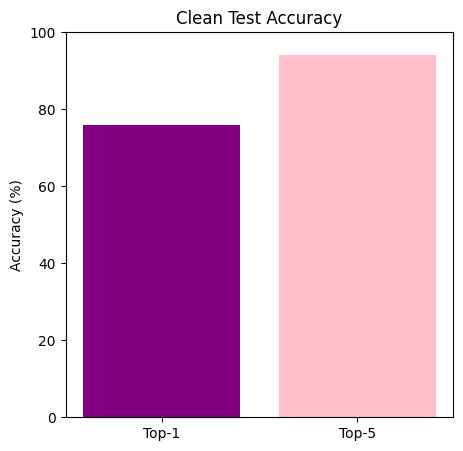

In [26]:
import torch
import torchvision
import torchvision.transforms as transforms
import torch.nn.functional as F
import numpy as np
import json
import re
from torch.utils.data import DataLoader

# 1. Set device
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

# 2. Load dataset
mean_norms = np.array([0.485, 0.456, 0.406], dtype=np.float32)
std_norms  = np.array([0.229, 0.224, 0.225], dtype=np.float32)
plain_transforms = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize(mean=mean_norms, std=std_norms)
])
dataset_path = "/content/drive/MyDrive/TestDataSet"
dataset = torchvision.datasets.ImageFolder(root=dataset_path, transform=plain_transforms)
test_loader = DataLoader(dataset, batch_size=32, shuffle=False)

# 3. Load label mapping
labels_json_path = "/content/drive/MyDrive/TestDataSet/labels_list.json"
with open(labels_json_path, "r") as f:
    label_entries = json.load(f)

class_names = []
for entry in label_entries:
    m = re.match(r"\d+: (.+)", entry)
    if m:
        class_names.append(m.group(1).strip())

wnids = dataset.classes
wnid_to_class = {wnid: class_name for wnid, class_name in zip(wnids, class_names)}
class_to_idx = {class_name: idx for idx, class_name in enumerate(class_names)}

# 4. Load pretrained ResNet-34
model = torchvision.models.resnet34(weights=torchvision.models.ResNet34_Weights.IMAGENET1K_V1).to(device)
model.eval()

# 5. Evaluation function now returns metrics
def evaluate_model(data_loader, dataset, wnid_to_class, class_to_idx):
    correct_top1 = 0
    correct_top5 = 0
    total = 0
    with torch.no_grad():
        for images, labels in data_loader:
            images = images.to(device)
            labels = labels.to(device)
            outputs = model(images)
            _, predicted = outputs.max(1)
            _, top5_preds = outputs.topk(5, 1, largest=True, sorted=True)
            for i in range(images.size(0)):
                true_wnid = dataset.classes[labels[i].item()]
                true_class_name = wnid_to_class[true_wnid]
                true_imagenet_idx = class_to_idx[true_class_name] + 401  # adjust offset if needed
                if predicted[i].item() == true_imagenet_idx:
                    correct_top1 += 1
                if true_imagenet_idx in top5_preds[i].tolist():
                    correct_top5 += 1
                total += 1
    top1 = 100. * correct_top1 / total
    top5 = 100. * correct_top5 / total
    return top1, top5

# 6. Run evaluation on clean test set
clean_top1, clean_top5 = evaluate_model(test_loader, dataset, wnid_to_class, class_to_idx)
print(f'Clean Top-1: {clean_top1:.2f}%, Top-5: {clean_top5:.2f}%')


# 7. Plotting bar charts
import matplotlib.pyplot as plt

# Single chart
plt.figure(figsize=(5,5))
plt.bar(['Top-1','Top-5'], [clean_top1, clean_top5], color=['purple','pink'])
plt.ylim(0,100)
plt.title('Clean Test Accuracy')
plt.ylabel('Accuracy (%)')
plt.show()



Task 2

Using device: cuda
Evaluating original model…


100%|██████████| 16/16 [00:03<00:00,  4.63it/s]


Original Top-1: 70.40%, Top-5: 93.20%


100%|██████████| 16/16 [00:05<00:00,  2.67it/s]


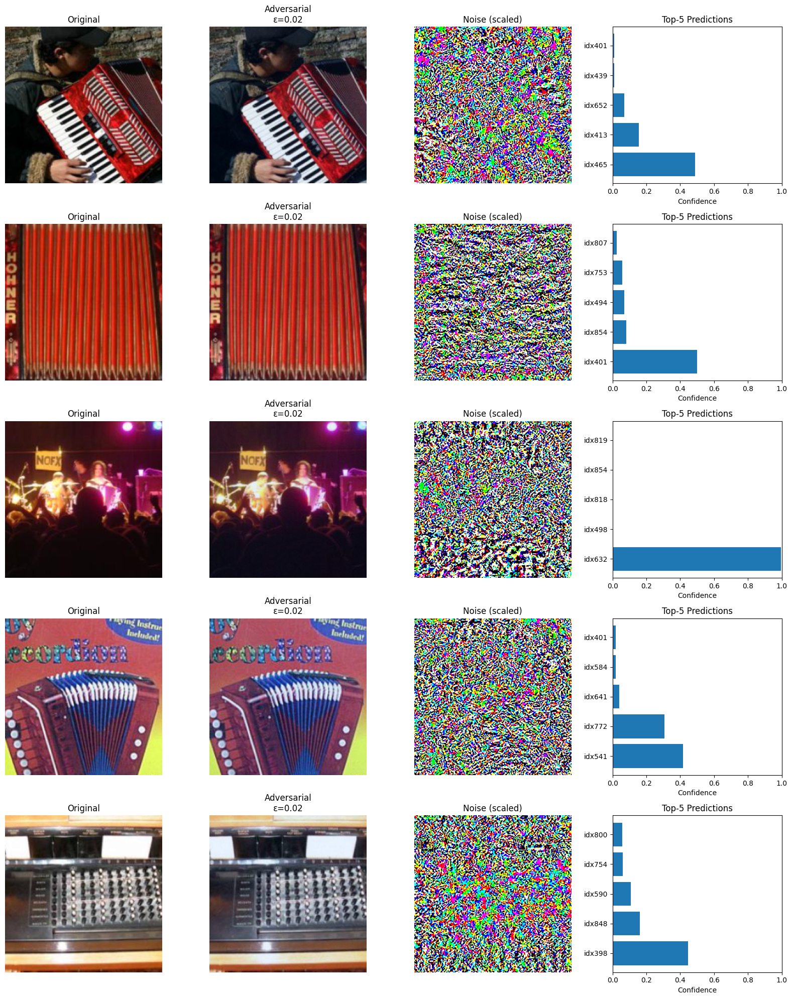

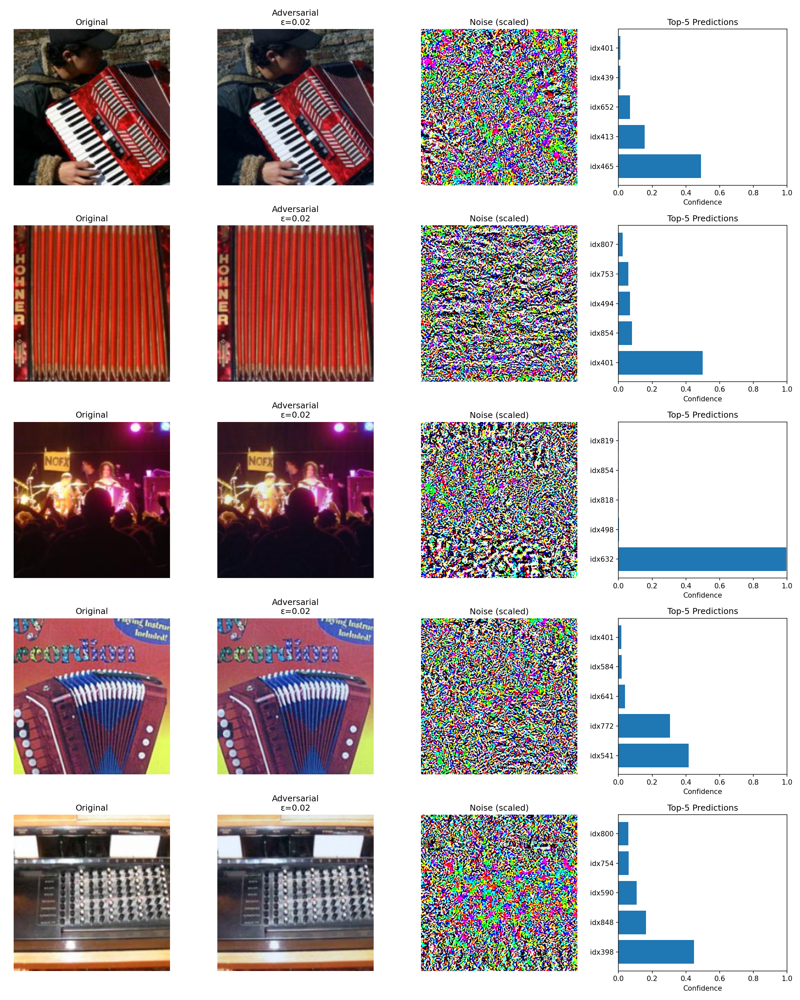


Evaluating on adversarial set…


100%|██████████| 16/16 [00:00<00:00, 17.13it/s]


Adversarial Top-1: 5.00%, Top-5: 30.20%

Verifying adversarial examples…

Verification Results:
  # images:       500
  Max L∞ dist:    0.020000
  Mean L∞ dist:   0.020000
  Within ε limit: 500/500
  Top-1 drop:     65.40%
  Top-5 drop:     63.00%


In [15]:
import torch
import torch.nn as nn
import torch.nn.functional as F
import torchvision.models as models
import torchvision.transforms as transforms
from torch.utils.data import DataLoader
from torchvision.datasets import ImageFolder
import matplotlib.pyplot as plt
import numpy as np
import os
import json
import re
from tqdm import tqdm
from IPython.display import display, Image as IPyImage

def load_model():
    model = models.resnet34(weights=models.ResNet34_Weights.IMAGENET1K_V1)
    model.eval()
    return model

def load_labels(path):
    with open(path, "r") as f:
        entries = json.load(f)
    class_names, class_ids = [], []
    for e in entries:
        m = re.match(r"(\d+): (.+)", e)
        if m:
            class_ids.append(int(m.group(1)))
            class_names.append(m.group(2).strip())
    return class_names, class_ids

def fgsm_attack(img, eps, grad, mean_ns, std_ns):
    # img is normalized float32
    mean = torch.tensor(mean_ns, dtype=torch.float32, device=img.device).view(1,3,1,1)
    std  = torch.tensor(std_ns,  dtype=torch.float32, device=img.device).view(1,3,1,1)
    denorm = img * std + mean
    signg  = grad.sign()
    pert = denorm + eps * std * signg
    pert = torch.clamp(pert, 0, 1)
    return (pert - mean) / std  # back to normalized

def evaluate_model(model, loader, device, dataset, wnid2name, name2idx):
    correct1 = correct5 = total = 0
    with torch.no_grad():
        for imgs, lbls in tqdm(loader):
            imgs = imgs.to(device).float()
            lbls = lbls.to(device)
            out = model(imgs)
            _, pred = out.max(1)
            _, t5   = out.topk(5, dim=1)
            for i in range(imgs.size(0)):
                wn = dataset.classes[lbls[i].item()]
                cname = wnid2name[wn]
                true_idx = name2idx[cname] + 401
                if pred[i].item() == true_idx:   correct1 += 1
                if true_idx in t5[i].tolist():   correct5 += 1
                total += 1
    return 100 * correct1 / total, 100 * correct5 / total

def visualize_attacks(orig_imgs, pert_imgs, labels,
                      model, class_names, mean_ns, std_ns,
                      eps, device, num_samples=5):
    """
    4-panel layout per sample:
      1) Original (de-normalized)
      2) Adversarial (raw normalized → global min/max)
      3) Noise (de-normalized diff → global min/max)
      4) Top-5 bar chart
    """
    plt.figure(figsize=(16, 4 * num_samples))

    mean = torch.tensor(mean_ns, dtype=torch.float32, device=device).view(1,3,1,1)
    std  = torch.tensor(std_ns,  dtype=torch.float32, device=device).view(1,3,1,1)

    for i in range(num_samples):
        o = orig_imgs[i].unsqueeze(0).to(device).float()
        p = pert_imgs[i].unsqueeze(0).to(device).float()

        # 1) Original: de-normalize
        orig_den = torch.clamp(o * std + mean, 0, 1)
        orig_vis = orig_den.cpu().squeeze().permute(1,2,0).numpy()

        # 2) Adversarial: raw normalized → global min/max scaling
        adv_raw = p.cpu().squeeze().permute(1,2,0).numpy()
        a_min, a_max = adv_raw.min(), adv_raw.max()
        adv_vis = (adv_raw - a_min) / (a_max - a_min + 1e-8)

        # 3) Noise: difference of de-normalized images → global min/max scaling
        pert_den = torch.clamp(p * std + mean, 0, 1)
        noise_raw = pert_den.cpu().squeeze().permute(1,2,0).numpy() - orig_vis
        nmin, nmax = noise_raw.min(), noise_raw.max()
        noise_vis = (noise_raw - nmin) / (nmax - nmin + 1e-8)

        # 4) Top-5 predictions on perturbed
        with torch.no_grad():
            logits = model(p)
            probs  = F.softmax(logits, dim=1).cpu().squeeze()
            top5_p, top5_i = probs.topk(5)

        # Plot each panel
        ax = plt.subplot(num_samples, 4, 4*i + 1)
        ax.imshow(orig_vis)
        ax.set_title("Original")
        ax.axis('off')

        ax = plt.subplot(num_samples, 4, 4*i + 2)
        ax.imshow(adv_vis)
        ax.set_title(f"Adversarial\nε={eps}")
        ax.axis('off')

        ax = plt.subplot(num_samples, 4, 4*i + 3)
        ax.imshow(noise_vis)
        ax.set_title("Noise (scaled)")
        ax.axis('off')

        ax = plt.subplot(num_samples, 4, 4*i + 4)
        labels5 = [class_names[idx] if idx < len(class_names) else f"idx{idx}"
                   for idx in top5_i.tolist()]
        ax.barh(range(5)[::-1], top5_p.tolist()[::-1])
        ax.set_yticks(range(5))
        ax.set_yticklabels(labels5[::-1])
        ax.set_xlim(0,1.0)
        ax.set_xlabel("Confidence")
        ax.set_title("Top-5 Predictions")

    plt.tight_layout()
    plt.savefig('task2_fgsm_attack_visualization.png', dpi=150)
    plt.show()
    display(IPyImage('task2_fgsm_attack_visualization.png'))

def verify_adversarial_examples(orig_imgs, pert_imgs, eps, o1, o5, a1, a5):
    dists = np.array([(p - o).abs().max().item()
                      for o,p in zip(orig_imgs, pert_imgs)])
    within = np.sum(dists <= eps + 1e-6)
    print("\nVerification Results:")
    print(f"  # images:       {len(dists)}")
    print(f"  Max L∞ dist:    {dists.max():.6f}")
    print(f"  Mean L∞ dist:   {dists.mean():.6f}")
    print(f"  Within ε limit: {within}/{len(dists)}")
    print(f"  Top-1 drop:     {o1 - a1:.2f}%")
    print(f"  Top-5 drop:     {o5 - a5:.2f}%")
    with open('adversarial_test_set_1/verification_results.txt','w') as f:
        f.write("Verification Results\n====================\n")
        f.write(f"# images:       {len(dists)}\n")
        f.write(f"Max L∞ dist:    {dists.max():.6f}\n")
        f.write(f"Mean L∞ dist:   {dists.mean():.6f}\n")
        f.write(f"Within ε limit: {within}/{len(dists)}\n")
        f.write(f"Top-1 drop:     {o1 - a1:.2f}%\n")
        f.write(f"Top-5 drop:     {o5 - a5:.2f}%\n")

def main():
    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
    print("Using device:", device)

    model = load_model().to(device)
    labels_json = "/content/drive/MyDrive/TestDataSet/labels_list.json"
    class_names, class_ids = load_labels(labels_json)

    # Ensure float32 arrays
    mean_norms = np.array([0.485, 0.456, 0.406], dtype=np.float32)
    std_norms  = np.array([0.229, 0.224, 0.225], dtype=np.float32)

    transform = transforms.Compose([
        transforms.Resize(256),
        transforms.CenterCrop(224),
        transforms.ToTensor(),
        transforms.Normalize(mean=mean_norms.tolist(),
                             std=std_norms.tolist())
    ])

    dataset = ImageFolder("/content/drive/MyDrive/TestDataSet", transform)
    loader  = DataLoader(dataset, batch_size=32, shuffle=False)

    wnid2name = {wn:cn for wn,cn in zip(dataset.classes, class_names)}
    name2idx  = {cn:i  for i,cn in enumerate(class_names)}

    eps = 0.02
    origs, perts, trues, preds = [], [], [], []

    print("Evaluating original model…")
    o1, o5 = evaluate_model(model, loader, device,
                            dataset, wnid2name, name2idx)
    print(f"Original Top-1: {o1:.2f}%, Top-5: {o5:.2f}%")

    for imgs, lbls in tqdm(loader):
        imgs = imgs.to(device).float()
        lbls = lbls.to(device)
        imgs.requires_grad = True

        out = model(imgs)
        true_indices = torch.tensor(
            [name2idx[wnid2name[dataset.classes[l.item()]]] + 401
             for l in lbls],
            device=device
        )
        loss = nn.CrossEntropyLoss()(out, true_indices)
        model.zero_grad(); loss.backward()

        pert = fgsm_attack(imgs, eps, imgs.grad, mean_norms, std_norms)

        origs.extend(imgs.detach().cpu())
        perts.extend(pert.detach().cpu())
        trues.extend(lbls.cpu())

        with torch.no_grad():
            adv_out = model(pert)
            _, p   = adv_out.max(1)
            preds.extend(p.cpu())

    # Visualize (inline + save)
    visualize_attacks(
        torch.stack(origs[:5]),
        torch.stack(perts[:5]),
        trues[:5],
        model, class_names, mean_norms, std_norms,
        eps, device, num_samples=5
    )

    # Save full adversarial set
    os.makedirs('adversarial_test_set_1', exist_ok=True)
    for i, (o,p) in enumerate(zip(origs, perts)):
        od = transforms.ToPILImage()(o * torch.tensor(std_norms).view(3,1,1) +
                                     torch.tensor(mean_norms).view(3,1,1))
        pd = transforms.ToPILImage()(p * torch.tensor(std_norms).view(3,1,1) +
                                     torch.tensor(mean_norms).view(3,1,1))
        od.save(f'adversarial_test_set_1/original_{i}.png')
        pd.save(f'adversarial_test_set_1/perturbed_{i}.png')

    adv_ds    = torch.utils.data.TensorDataset(torch.stack(perts),
                                               torch.tensor(trues))
    adv_loader= DataLoader(adv_ds, batch_size=32, shuffle=False)

    print("\nEvaluating on adversarial set…")
    a1, a5 = evaluate_model(model, adv_loader, device,
                            dataset, wnid2name, name2idx)
    print(f"Adversarial Top-1: {a1:.2f}%, Top-5: {a5:.2f}%")

    print("\nVerifying adversarial examples…")
    os.makedirs('adversarial_test_set_1', exist_ok=True)
    verify_adversarial_examples(
        torch.stack(origs),
        torch.stack(perts),
        eps, o1, o5, a1, a5
    )

if __name__ == "__main__":
    main()


Task 3

Using device: cuda
Evaluating original model...


100%|██████████| 16/16 [00:03<00:00,  4.86it/s]


Original Model - Top-1: 70.40%, Top-5: 93.20%


100%|██████████| 16/16 [00:26<00:00,  1.67s/it]


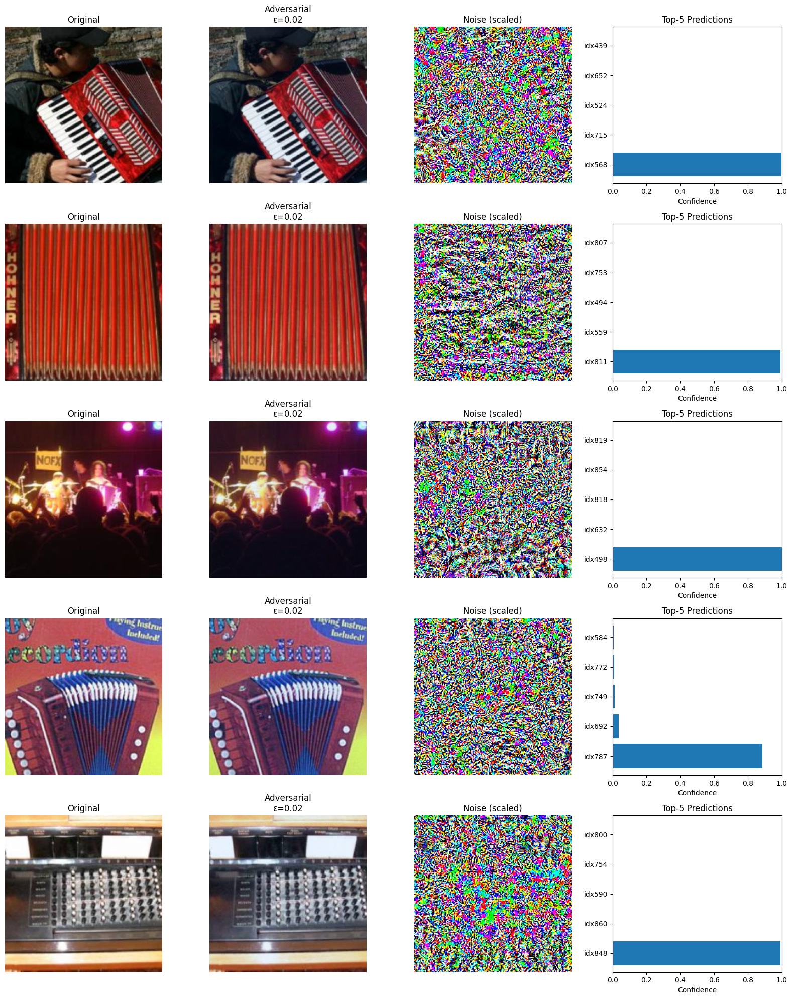

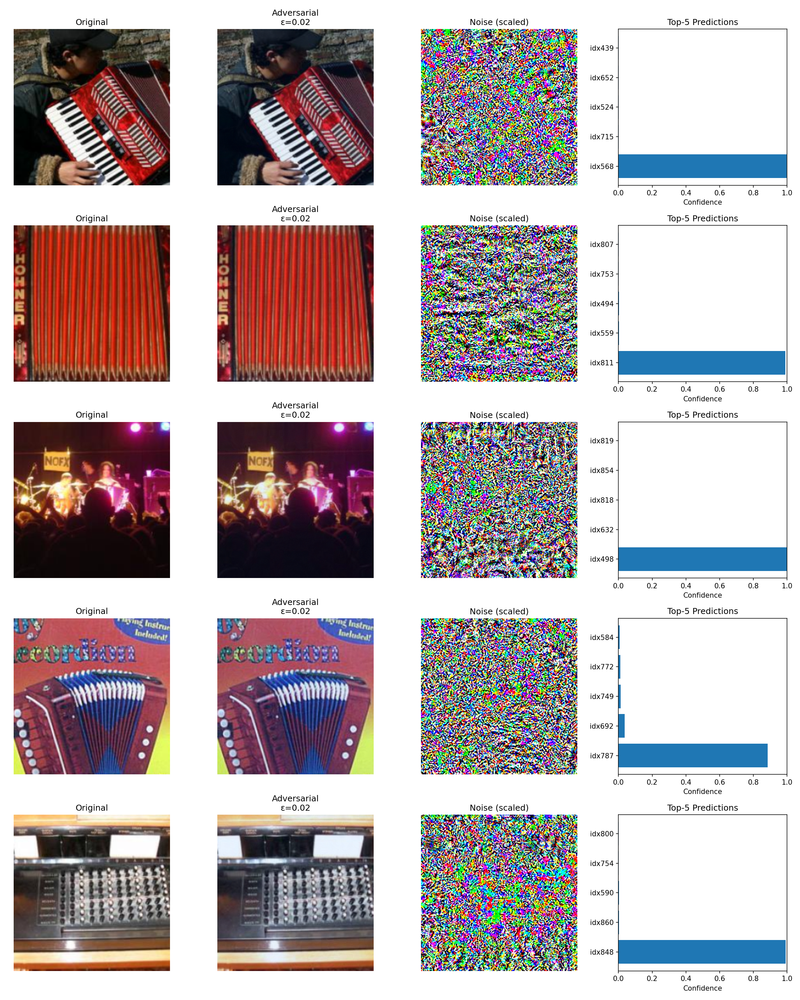

100%|██████████| 16/16 [00:00<00:00, 17.62it/s]



Adversarial Model - Top-1: 0.20%, Top-5: 8.60%

Verifying adversarial examples...

Verification Results:
Number of images: 500
Max L∞ distance:  0.020000
Mean L∞ distance: 0.020000
Within ε limit:    500/500
Top-1 drop:        70.20%
Top-5 drop:        84.60%


In [16]:
import torch
import torch.nn as nn
import torch.nn.functional as F
import torchvision.models as models
import torchvision.transforms as transforms
from torch.utils.data import DataLoader
from torchvision.datasets import ImageFolder
import matplotlib.pyplot as plt
import numpy as np
import os
import json
import re
from tqdm import tqdm
from IPython.display import display, Image as IPyImage

def load_model():
    model = models.resnet34(weights=models.ResNet34_Weights.IMAGENET1K_V1)
    model.eval()
    return model

def load_labels(path):
    with open(path, "r") as f:
        entries = json.load(f)
    class_names, class_ids = [], []
    for e in entries:
        m = re.match(r"(\d+): (.+)", e)
        if m:
            class_ids.append(int(m.group(1)))
            class_names.append(m.group(2).strip())
    return class_names, class_ids

def momentum_iterative_fgsm_attack(model, image, epsilon, mean_ns, std_ns, true_indices, num_steps=10, momentum=0.9):
    mean = torch.tensor(mean_ns, device=image.device, dtype=torch.float32).view(1,3,1,1)
    std  = torch.tensor(std_ns, device=image.device, dtype=torch.float32).view(1,3,1,1)
    image = image.float()
    perturbed = image.clone()
    g_mom = torch.zeros_like(image)
    alpha = epsilon / num_steps

    for _ in range(num_steps):
        perturbed.requires_grad_(True)
        outputs = model(perturbed)
        loss = nn.CrossEntropyLoss()(outputs, true_indices)
        model.zero_grad(); loss.backward()
        grad = perturbed.grad.data.sign()
        g_mom = momentum * g_mom + alpha * grad
        perturbed = perturbed.detach() + g_mom
        # project back
        delta = torch.clamp(perturbed - image, -epsilon, epsilon)
        perturbed = image + delta
        # clip to [0,1] in pixel space
        pert_denorm = torch.clamp(perturbed * std + mean, 0, 1)
        perturbed = (pert_denorm - mean) / std

    return perturbed.detach()

def evaluate_model(model, dataloader, device, dataset, wnid2name, name2idx):
    top1 = top5 = total = 0
    with torch.no_grad():
        for imgs, lbls in tqdm(dataloader):
            imgs = imgs.to(device).float()
            lbls = lbls.to(device)
            out = model(imgs)
            _, pred = out.max(1)
            _, t5   = out.topk(5, dim=1)
            for i in range(imgs.size(0)):
                wn = dataset.classes[lbls[i].item()]
                idx = name2idx[wnid2name[wn]] + 401
                if pred[i].item() == idx:     top1 += 1
                if idx in t5[i].tolist():     top5 += 1
                total += 1
    return 100*top1/total, 100*top5/total

def visualize_attacks(model, orig_imgs, pert_imgs, class_names, mean_ns, std_ns, epsilon, device, num_samples=5):
    """
    4-panel per sample:
      1) Original (de-normalized)
      2) Adversarial (raw normalized → global min/max)
      3) Noise (de-normalized diff → global min/max)
      4) Top-5 bar chart
    """
    plt.figure(figsize=(16, 4 * num_samples))
    mean = torch.tensor(mean_ns, dtype=torch.float32, device=device).view(1,3,1,1)
    std  = torch.tensor(std_ns,  dtype=torch.float32, device=device).view(1,3,1,1)

    for i in range(num_samples):
        o = orig_imgs[i].unsqueeze(0).to(device).float()
        p = pert_imgs[i].unsqueeze(0).to(device).float()

        # 1) Original de-normalized
        orig_den = torch.clamp(o * std + mean, 0, 1)
        orig_vis = orig_den.cpu().squeeze().permute(1,2,0).numpy()

        # 2) Adversarial raw normalized → global min/max
        adv_raw = p.cpu().squeeze().permute(1,2,0).numpy()
        a_min, a_max = adv_raw.min(), adv_raw.max()
        adv_vis = (adv_raw - a_min) / (a_max - a_min + 1e-8)

        # 3) Noise: difference of de-normalized images → global min/max
        pert_den = torch.clamp(p * std + mean, 0, 1)
        noise_raw = pert_den.cpu().squeeze().permute(1,2,0).numpy() - orig_vis
        nmin, nmax = noise_raw.min(), noise_raw.max()
        noise_vis = (noise_raw - nmin) / (nmax - nmin + 1e-8)

        # 4) Top-5 predictions on perturbed
        with torch.no_grad():
            logits = model(p)
            probs  = F.softmax(logits, dim=1).cpu().squeeze()
            top5_p, top5_i = probs.topk(5)

        # Plot panels
        ax = plt.subplot(num_samples, 4, 4*i + 1)
        ax.imshow(orig_vis);         ax.set_title("Original");        ax.axis('off')

        ax = plt.subplot(num_samples, 4, 4*i + 2)
        ax.imshow(adv_vis);          ax.set_title(f"Adversarial\nε={epsilon}"); ax.axis('off')

        ax = plt.subplot(num_samples, 4, 4*i + 3)
        ax.imshow(noise_vis);        ax.set_title("Noise (scaled)");  ax.axis('off')

        ax = plt.subplot(num_samples, 4, 4*i + 4)
        labels5 = [class_names[idx] if idx < len(class_names) else f"idx{idx}" for idx in top5_i.tolist()]
        ax.barh(range(5)[::-1], top5_p.tolist()[::-1])
        ax.set_yticks(range(5)); ax.set_yticklabels(labels5[::-1])
        ax.set_xlim(0,1.0); ax.set_xlabel("Confidence")
        ax.set_title("Top-5 Predictions")

    plt.tight_layout()
    plt.savefig('task3_improved_attack_visualization.png', dpi=150)
    plt.show()
    display(IPyImage('task3_improved_attack_visualization.png'))

def verify_adversarial_examples(orig_imgs, pert_imgs, epsilon, o1, o5, a1, a5):
    dists = np.array([(p - o).abs().max().item() for o,p in zip(orig_imgs, pert_imgs)])
    within = np.sum(dists <= epsilon + 1e-6)
    print("\nVerification Results:")
    print(f"Number of images: {len(dists)}")
    print(f"Max L∞ distance:  {dists.max():.6f}")
    print(f"Mean L∞ distance: {dists.mean():.6f}")
    print(f"Within ε limit:    {within}/{len(dists)}")
    print(f"Top-1 drop:        {o1 - a1:.2f}%")
    print(f"Top-5 drop:        {o5 - a5:.2f}%")
    os.makedirs('adversarial_test_set_2', exist_ok=True)
    with open('adversarial_test_set_2/verification_results.txt','w') as f:
        f.write("Verification Results\n====================\n")
        f.write(f"# images:        {len(dists)}\n")
        f.write(f"Max L∞:          {dists.max():.6f}\n")
        f.write(f"Mean L∞:         {dists.mean():.6f}\n")
        f.write(f"Within ε limit:  {within}/{len(dists)}\n")
        f.write(f"Top-1 drop:      {o1 - a1:.2f}%\n")
        f.write(f"Top-5 drop:      {o5 - a5:.2f}%\n")

def main():
    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
    print(f"Using device: {device}")

    model = load_model().to(device)
    labels_json = "/content/drive/MyDrive/TestDataSet/labels_list.json"
    class_names, _ = load_labels(labels_json)

    mean_norms = np.array([0.485, 0.456, 0.406], dtype=np.float32)
    std_norms  = np.array([0.229, 0.224, 0.225], dtype=np.float32)
    transform = transforms.Compose([
        transforms.Resize(256),
        transforms.CenterCrop(224),
        transforms.ToTensor(),
        transforms.Normalize(mean=mean_norms.tolist(), std=std_norms.tolist())
    ])

    dataset = ImageFolder("/content/drive/MyDrive/TestDataSet", transform)
    loader  = DataLoader(dataset, batch_size=32, shuffle=False)
    wnid2name = {wn:cn for wn,cn in zip(dataset.classes, class_names)}
    name2idx  = {cn:i  for i,cn in enumerate(class_names)}

    epsilon = 0.02
    original_images, perturbed_images, true_labels, predictions = [], [], [], []

    print("Evaluating original model...")
    orig_t1, orig_t5 = evaluate_model(model, loader, device, dataset, wnid2name, name2idx)
    print(f"Original Model - Top-1: {orig_t1:.2f}%, Top-5: {orig_t5:.2f}%")

    model.eval()
    for images, labels in tqdm(loader):
        images, labels = images.to(device), labels.to(device)
        true_indices = torch.tensor(
            [name2idx[wnid2name[dataset.classes[l.item()]]] + 401 for l in labels],
            device=device
        )
        pert = momentum_iterative_fgsm_attack(model, images, epsilon, mean_norms, std_norms, true_indices)
        original_images.extend(images.detach().cpu())
        perturbed_images.extend(pert.detach().cpu())
        true_labels.extend(labels.cpu())

    # visualize
    visualize_attacks(
        model,
        torch.stack(original_images[:5]),
        torch.stack(perturbed_images[:5]),
        class_names,
        mean_norms,
        std_norms,
        epsilon,
        device,
        num_samples=5
    )

    # save images
    os.makedirs('adversarial_test_set_2', exist_ok=True)
    for i, (o, p) in enumerate(zip(original_images, perturbed_images)):
        od = transforms.ToPILImage()(o * torch.tensor(std_norms).view(3,1,1) +
                                     torch.tensor(mean_norms).view(3,1,1))
        pd = transforms.ToPILImage()(p * torch.tensor(std_norms).view(3,1,1) +
                                     torch.tensor(mean_norms).view(3,1,1))
        od.save(f'adversarial_test_set_2/original_{i}.png')
        pd.save(f'adversarial_test_set_2/perturbed_{i}.png')

    # evaluate on adversarial set
    adv_dataset = torch.utils.data.TensorDataset(torch.stack(perturbed_images),
                                                 torch.tensor(true_labels))
    adv_loader  = DataLoader(adv_dataset, batch_size=32, shuffle=False)
    adv_t1, adv_t5 = evaluate_model(model, adv_loader, device, dataset, wnid2name, name2idx)
    print(f"\nAdversarial Model - Top-1: {adv_t1:.2f}%, Top-5: {adv_t5:.2f}%")

    print("\nVerifying adversarial examples...")
    verify_adversarial_examples(
        torch.stack(original_images),
        torch.stack(perturbed_images),
        epsilon,
        orig_t1, orig_t5,
        adv_t1, adv_t5
    )

if __name__ == "__main__":
    main()


Task 4

Eval: 100%|██████████| 16/16 [00:03<00:00,  4.82it/s]


Original Top-1: 70.40%, Top-5: 93.20%


Eval: 100%|██████████| 16/16 [00:00<00:00, 17.70it/s]


Adversarial Top-1: 23.80%, Top-5: 63.20%


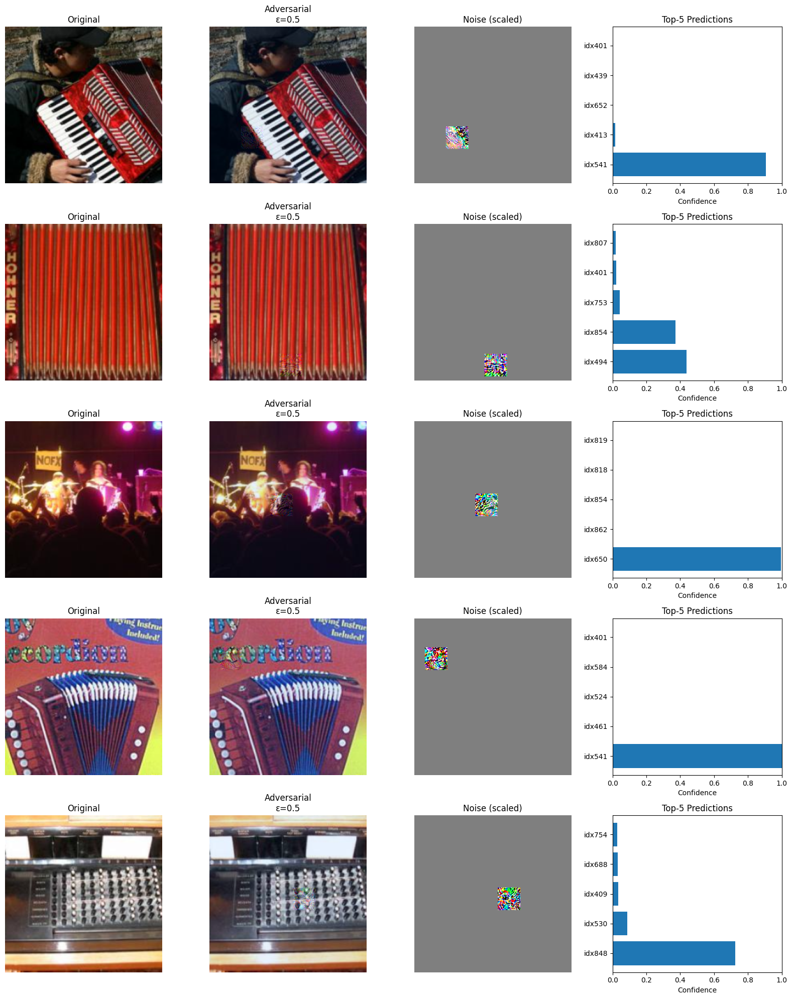

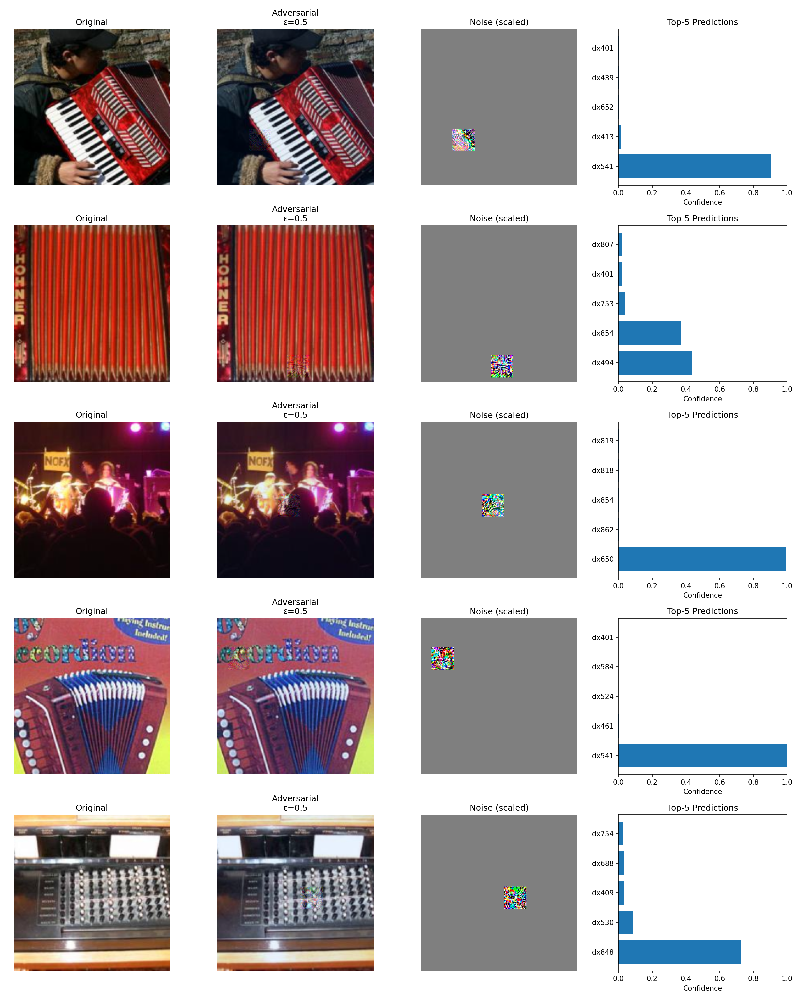


Verifying adversarial examples...

Verification Results:
 Number of images: 500
 Max L∞ distance:  0.500000
 Mean L∞ distance: 0.500000
 Within ε limit:   500/500
 Top-1 drop:        46.60%
 Top-5 drop:        30.00%


In [19]:
import torch
import torch.nn as nn
import torch.nn.functional as F
import torchvision.models as models
import torchvision.transforms as transforms
from torch.utils.data import DataLoader, TensorDataset
from torchvision.datasets import ImageFolder
from PIL import Image
import matplotlib.pyplot as plt
import numpy as np
import os
import json
import re
from tqdm import tqdm
from IPython.display import display, Image as IPyImage

def load_model():
    m = models.resnet34(weights=models.ResNet34_Weights.IMAGENET1K_V1)
    m.eval()
    return m

def load_labels(path):
    with open(path, "r") as f:
        entries = json.load(f)
    names = []
    for e in entries:
        m = re.match(r"(\d+): (.+)", e)
        if m:
            names.append(m.group(2).strip())
    return names

def patch_mifgsm_untargeted(model, images, epsilon, mean_ns, std_ns,
                            true_indices, patch_size=32, num_steps=30, momentum=0.95):
    device = images.device
    mean = torch.tensor(mean_ns, device=device).view(1,3,1,1)
    std  = torch.tensor(std_ns, device=device).view(1,3,1,1)
    x = images.float()
    B,_,H,W = x.shape

    # choose random patch per image
    xs = torch.randint(0, H - patch_size + 1, (B,), device=device)
    ys = torch.randint(0, W - patch_size + 1, (B,), device=device)

    pert = x.clone()
    m_buf = torch.zeros_like(x)
    alpha = epsilon / num_steps

    for _ in range(num_steps):
        pert.requires_grad_(True)
        logits = model(pert)
        loss = nn.CrossEntropyLoss()(logits, true_indices)
        model.zero_grad(); loss.backward()
        g = pert.grad.data.sign()

        # mask gradient outside patch
        mask = torch.zeros_like(x)
        for i in range(B):
            mask[i, :, xs[i]:xs[i]+patch_size, ys[i]:ys[i]+patch_size] = 1.0
        g = g * mask

        # momentum update
        m_buf = momentum * m_buf + alpha * g
        pert = pert.detach() + m_buf

        # project back into ε-ball
        delta = torch.clamp(pert - x, -epsilon, epsilon)
        pert = x + delta

        # clip pixel range [0,1]
        den = torch.clamp(pert * std + mean, 0, 1)
        pert = (den - mean) / std

    return pert.detach()

def evaluate(model, loader, device, dataset):
    wnids = dataset.classes
    idx_map = {wn:i for i,wn in enumerate(wnids)}
    c1 = c5 = tot = 0
    with torch.no_grad():
        for imgs, lbls in tqdm(loader, desc="Eval"):
            imgs, lbls = imgs.to(device).float(), lbls.to(device)
            outs = model(imgs)
            _, p1 = outs.max(1)
            _, p5 = outs.topk(5, 1, True, True)
            for i in range(imgs.size(0)):
                true_idx = idx_map[wnids[lbls[i].item()]] + 401
                if p1[i].item() == true_idx: c1 += 1
                if true_idx in p5[i].tolist(): c5 += 1
                tot += 1
    return 100 * c1 / tot, 100 * c5 / tot

def visualize_patch_attacks(model, origs, perts, labels, preds,
                            class_names, epsilon, mean_ns, std_ns, device, num=5):
    """
    4-panel per sample:
      1) Original (de-normalized)
      2) Adversarial (raw normalized → global min/max)
      3) Noise (de-normalized diff → global min/max)
      4) Top-5 bar chart
    """
    plt.figure(figsize=(16, 4 * num))
    mean = torch.tensor(mean_ns, dtype=torch.float32, device=device).view(1,3,1,1)
    std  = torch.tensor(std_ns,  dtype=torch.float32, device=device).view(1,3,1,1)

    for i in range(num):
        o = origs[i].unsqueeze(0).to(device).float()
        p = perts[i].unsqueeze(0).to(device).float()

        # 1) Original de-normalized
        orig_den = torch.clamp(o * std + mean, 0, 1)
        orig_vis = orig_den.cpu().squeeze().permute(1,2,0).numpy()

        # 2) Adversarial raw normalized → global min/max
        adv_raw = p.cpu().squeeze().permute(1,2,0).numpy()
        a_min, a_max = adv_raw.min(), adv_raw.max()
        adv_vis = (adv_raw - a_min) / (a_max - a_min + 1e-8)

        # 3) Noise: (denorm pert - orig) → global min/max
        pert_den = torch.clamp(p * std + mean, 0, 1)
        noise_raw = pert_den.cpu().squeeze().permute(1,2,0).numpy() - orig_vis
        nmin, nmax = noise_raw.min(), noise_raw.max()
        noise_vis = (noise_raw - nmin) / (nmax - nmin + 1e-8)

        # 4) Top-5 on perturbed
        with torch.no_grad():
            logits = model(p)
            probs  = F.softmax(logits, dim=1).cpu().squeeze()
            top5_p, top5_i = probs.topk(5)

        # Plot panels
        ax = plt.subplot(num, 4, 4*i + 1)
        ax.imshow(orig_vis); ax.set_title("Original");        ax.axis('off')

        ax = plt.subplot(num, 4, 4*i + 2)
        ax.imshow(adv_vis);  ax.set_title(f"Adversarial\nε={epsilon}"); ax.axis('off')

        ax = plt.subplot(num, 4, 4*i + 3)
        ax.imshow(noise_vis); ax.set_title("Noise (scaled)");  ax.axis('off')

        ax = plt.subplot(num, 4, 4*i + 4)
        labels5 = [class_names[idx] if idx < len(class_names) else f"idx{idx}"
                   for idx in top5_i.tolist()]
        ax.barh(range(5)[::-1], top5_p.tolist()[::-1])
        ax.set_yticks(range(5)); ax.set_yticklabels(labels5[::-1])
        ax.set_xlim(0,1.0); ax.set_xlabel("Confidence")
        ax.set_title("Top-5 Predictions")

    plt.tight_layout()
    plt.savefig('task4_patch_attack.png', dpi=150)
    plt.show()
    display(IPyImage('task4_patch_attack.png'))

def verify_adversarial_examples(origs, perts, epsilon, o1, o5, a1, a5):
    dists = np.array([(p - o).abs().max().item() for o,p in zip(origs, perts)])
    within = np.sum(dists <= epsilon + 1e-6)
    print("\nVerification Results:")
    print(f" Number of images: {len(dists)}")
    print(f" Max L∞ distance:  {dists.max():.6f}")
    print(f" Mean L∞ distance: {dists.mean():.6f}")
    print(f" Within ε limit:   {within}/{len(dists)}")
    print(f" Top-1 drop:        {o1 - a1:.2f}%")
    print(f" Top-5 drop:        {o5 - a5:.2f}%")
    os.makedirs('Adversarial_Test_Set_3', exist_ok=True)
    with open('Adversarial_Test_Set_3/verification_results.txt', 'w') as f:
        f.write("Verification Results for Patch Attack\n")
        f.write("======================================\n")
        f.write(f"# images:        {len(dists)}\n")
        f.write(f"Max L∞:          {dists.max():.6f}\n")
        f.write(f"Mean L∞:         {dists.mean():.6f}\n")
        f.write(f"Within ε limit:  {within}/{len(dists)}\n")
        f.write(f"Top-1 drop:      {o1 - a1:.2f}%\n")
        f.write(f"Top-5 drop:      {o5 - a5:.2f}%\n")

if __name__=="__main__":
    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
    model  = load_model().to(device)

    root = "/content/drive/MyDrive/TestDataSet"
    class_names = load_labels(f"{root}/labels_list.json")

    mean_norms = [0.485,0.456,0.406]
    std_norms  = [0.229,0.224,0.225]
    transform = transforms.Compose([
        transforms.Resize(256),
        transforms.CenterCrop(224),
        transforms.ToTensor(),
        transforms.Normalize(mean=mean_norms, std=std_norms),
    ])

    dataset = ImageFolder(root, transform=transform)
    loader  = DataLoader(dataset, batch_size=32, shuffle=False)

    # 1) Original accuracy
    orig1, orig5 = evaluate(model, loader, device, dataset)
    print(f"Original Top-1: {orig1:.2f}%, Top-5: {orig5:.2f}%")

    # 2) Untargeted patch attack
    epsilon = 0.5
    originals, perturbs, true_labels, predictions = [], [], [], []

    model.eval()
    for imgs, lbls in tqdm(loader, desc="Patch Attack"):
        imgs, lbls = imgs.to(device), lbls.to(device)
        true_indices = torch.tensor([lbl.item() + 401 for lbl in lbls], device=device)

        pert = patch_mifgsm_untargeted(
            model, imgs, epsilon, mean_norms, std_norms, true_indices,
            patch_size=32, num_steps=30, momentum=0.95
        )

        originals.extend(imgs.cpu())
        perturbs.extend(pert.cpu())
        true_labels.extend(lbls.cpu())
        with torch.no_grad():
            _, p = model(pert).max(1)
            predictions.extend(p.cpu())

    # 3) Save Adversarial Test Set 3
    os.makedirs("adversarial_Test_Set_3", exist_ok=True)
    inv_std  = torch.tensor(std_norms).view(3,1,1)
    inv_mean = torch.tensor(mean_norms).view(3,1,1)
    for i,(o,p) in enumerate(zip(originals, perturbs)):
        o_img = transforms.ToPILImage()((o*inv_std+inv_mean).clamp(0,1))
        p_img = transforms.ToPILImage()((p*inv_std+inv_mean).clamp(0,1))
        o_img.save(f"Adversarial_Test_Set_3/original_{i}.png")
        p_img.save(f"Adversarial_Test_Set_3/perturbed_{i}.png")

    # 4) Evaluate adversarial set
    adv_ds = TensorDataset(torch.stack(perturbs), torch.tensor(true_labels))
    adv_ld = DataLoader(adv_ds, batch_size=32, shuffle=False)
    adv1, adv5 = evaluate(model, adv_ld, device, dataset)
    print(f"Adversarial Top-1: {adv1:.2f}%, Top-5: {adv5:.2f}%")

    # 5) Visual comparison of 5 examples
    visualize_patch_attacks(
        model,
        torch.stack(originals[:5]),
        torch.stack(perturbs[:5]),
        true_labels[:5],
        predictions[:5],
        class_names,
        epsilon,
        mean_norms,
        std_norms,
        device,
        num=5
    )

    # 6) Verification
    print("\nVerifying adversarial examples...")
    verify_adversarial_examples(
        torch.stack(originals),
        torch.stack(perturbs),
        epsilon,
        orig1,
        orig5,
        adv1,
        adv5
    )


Task 5

Detected while troubleshooting that both the perturbed and original images are being saved, code to remove the orginal images in dataset

In [22]:
import os

def clean_adversarial_dataset(set_name, set_path):
    print(f"\nCleaning {set_name} at {set_path}...")
    print("=" * 50)

    # Check if directory exists
    if not os.path.exists(set_path):
        print(f"ERROR: Directory {set_path} does not exist!")
        return False

    # Get list of all PNG files
    files = [f for f in os.listdir(set_path) if f.endswith('.png')]
    expected_files = [f"perturbed_{i}.png" for i in range(500)]

    # Identify and remove unexpected files
    unexpected_files = [f for f in files if f not in expected_files]
    if unexpected_files:
        print(f"Removing {len(unexpected_files)} unexpected files...")
        for f in unexpected_files:
            os.remove(os.path.join(set_path, f))
            print(f"  - Removed {f}")
    else:
        print("No unexpected files found.")

    # Verify remaining files
    remaining_files = [f for f in os.listdir(set_path) if f.endswith('.png')]
    if len(remaining_files) == 500 and all(f in expected_files for f in remaining_files):
        print("Directory now contains exactly 500 perturbed images!")
        return True
    else:
        print(f"Directory contains {len(remaining_files)} files. Expected 500.")
        return False

def main():
    # Define paths to adversarial datasets
    adversarial_sets = [
        ("adversarial_test_set_1", "adversarial_test_set_1"),
        ("adversarial_test_set_2", "adversarial_test_set_2"),
        ("Adversarial_Test_Set 3", "Adversarial_Test_Set_3")
    ]

    # Clean each dataset
    all_valid = True
    for set_name, set_path in adversarial_sets:
        valid = clean_adversarial_dataset(set_name, set_path)
        all_valid = all_valid and valid

    if all_valid:
        print("\nAll adversarial datasets are now clean with 500 images each!")
    else:
        print("\nSome adversarial datasets still have issues. Please check the output above.")

if __name__ == "__main__":
    main()


Cleaning adversarial_test_set_1 at adversarial_test_set_1...
No unexpected files found.
Directory now contains exactly 500 perturbed images!

Cleaning adversarial_test_set_2 at adversarial_test_set_2...
No unexpected files found.
Directory now contains exactly 500 perturbed images!

Cleaning Adversarial_Test_Set 3 at Adversarial_Test_Set_3...
Removing 500 unexpected files...
  - Removed original_450.png
  - Removed original_176.png
  - Removed original_38.png
  - Removed original_318.png
  - Removed original_381.png
  - Removed original_488.png
  - Removed original_35.png
  - Removed original_485.png
  - Removed original_369.png
  - Removed original_431.png
  - Removed original_42.png
  - Removed original_215.png
  - Removed original_226.png
  - Removed original_466.png
  - Removed original_260.png
  - Removed original_443.png
  - Removed original_469.png
  - Removed original_164.png
  - Removed original_112.png
  - Removed original_27.png
  - Removed original_486.png
  - Removed orig

TASK 5: We used DenseNet-121 as the alternate method

In [25]:
import torch
import torch.nn as nn
import torchvision.models as models
import torchvision.transforms as transforms
from torch.utils.data import DataLoader, TensorDataset
from torchvision.datasets import ImageFolder
from PIL import Image
import numpy as np
import json
import re
from tqdm import tqdm


# To load the preferred model DenseNet-121 and set it to evalutation model
def load_model():
    model = models.densenet121(weights=models.DenseNet121_Weights.IMAGENET1K_V1)
    model.eval()
    return model

def load_labels(labels_json_path):
    with open(labels_json_path, "r") as f:
        label_entries = json.load(f)
    class_names = []
    class_ids = []
    for entry in label_entries:
        match = re.match(r"(\d+): (.+)", entry)
        if match:
            class_id = int(match.group(1))
            class_name = match.group(2).strip()
            class_names.append(class_name)
            class_ids.append(class_id)
    return class_names, class_ids

#Evaluation the model and comparing accuracies
def evaluate_model(model, dataloader, device, dataset, wnid_to_class, class_to_idx):
    correct_top1 = 0
    correct_top5 = 0
    total = 0
    with torch.no_grad():
        for images, labels in tqdm(dataloader):
            images = images.to(device)
            labels = labels.to(device)
            outputs = model(images)
            _, predicted = outputs.max(1)
            _, top5_preds = outputs.topk(5, 1, largest=True, sorted=True)
            for i in range(images.size(0)):
                true_wnid = dataset.classes[labels[i].item()] if dataset else None
                true_class_name = wnid_to_class[true_wnid] if true_wnid else class_names[labels[i].item()]
                true_imagenet_idx = class_to_idx[true_class_name] + 401
                if predicted[i].item() == true_imagenet_idx:
                    correct_top1 += 1
                if true_imagenet_idx in top5_preds[i].tolist():
                    correct_top5 += 1
                total += 1
    top1_accuracy = 100. * correct_top1 / total
    top5_accuracy = 100. * correct_top5 / total
    return top1_accuracy, top5_accuracy

def main():
    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
    print(f"Using device: {device}")

    model = load_model().to(device)

    labels_json_path = "/content/drive/MyDrive/TestDataSet/labels_list.json"
    class_names, class_ids = load_labels(labels_json_path)

    mean_norms = np.array([0.485, 0.456, 0.406])
    std_norms = np.array([0.229, 0.224, 0.225])
    def jpeg_compression(img):
        img.save("temp.jpg", quality=90)
        return Image.open("temp.jpg").convert("RGB")
#Define the transform
    transform = transforms.Compose([
        transforms.Lambda(jpeg_compression), #compress jpeg file
        transforms.GaussianBlur(kernel_size=3, sigma=0.5), #apply gaussain blur
        transforms.Resize(256), #resize
        transforms.CenterCrop(224), #Crop to 224x224
        transforms.ToTensor(),
        transforms.Normalize(mean=mean_norms, std=std_norms)
    ])

    dataset_path = "/content/drive/MyDrive/TestDataSet"
    dataset = ImageFolder(root=dataset_path, transform=transform)
    test_loader = DataLoader(dataset, batch_size=32, shuffle=False)

    wnids = dataset.classes
    wnid_to_class = {wnid: class_name for wnid, class_name in zip(wnids, class_names)}
    class_to_idx = {class_name: idx for idx, class_name in enumerate(class_names)}

    adversarial_sets = [
        ("Adversarial Test Set 1", "adversarial_test_set_1"),
        ("Adversarial Test Set 2", "adversarial_test_set_2"),
        ("Adversarial Test Set 3", "Adversarial_Test_Set_3")
    ]

    results = {}

    print("\nEvaluating DenseNet-121 on original dataset...")
    original_top1, original_top5 = evaluate_model(model, test_loader, device, dataset, wnid_to_class, class_to_idx)
    results["Original"] = {"Top-1": original_top1, "Top-5": original_top5}
    print(f"Original Dataset - Top-1 Accuracy: {original_top1:.2f}%, Top-5 Accuracy: {original_top5:.2f}%")

    for set_name, set_path in adversarial_sets:
        print(f"\nEvaluating DenseNet-121 on {set_name}...")
        perturbed_images = []
        true_labels = []
        for i in range(500):
            pert_img = Image.open(f"{set_path}/perturbed_{i}.png")
            pert_img = transform(pert_img).cpu()
            perturbed_images.append(pert_img)
            orig_path = dataset.samples[i][0]
            label = dataset.classes.index(orig_path.split('/')[-2])
            true_labels.append(label)

        adversarial_dataset = TensorDataset(
            torch.stack(perturbed_images),
            torch.tensor(true_labels)
        )
        adversarial_loader = DataLoader(adversarial_dataset, batch_size=32, shuffle=False)

        adv_top1, adv_top5 = evaluate_model(model, adversarial_loader, device, dataset, wnid_to_class, class_to_idx)
        results[set_name] = {"Top-1": adv_top1, "Top-5": adv_top5}
        print(f"{set_name} - Top-1 Accuracy: {adv_top1:.2f}%, Top-5 Accuracy: {adv_top5:.2f}%")

    print("\nSummary of Results on DenseNet-121:")
    print("=" * 50)
    print(f"{'Dataset':<25} {'Top-1 Accuracy':<15} {'Top-5 Accuracy':<15}")
    print("-" * 50)
    for dataset_name, accuracies in results.items():
        print(f"{dataset_name:<25} {accuracies['Top-1']:<15.2f} {accuracies['Top-5']:<15.2f}")
    print("=" * 50)


    with open('task5_output.txt', 'w') as f:
        f.write("Task 5: Transferability Results on DenseNet-121\n")
        f.write("=" * 50 + "\n")
        f.write(f"{'Dataset':<25} {'Top-1 Accuracy':<15} {'Top-5 Accuracy':<15}\n")
        f.write("-" * 50 + "\n")
        for dataset_name, accuracies in results.items():
            f.write(f"{dataset_name:<25} {accuracies['Top-1']:<15.2f} {accuracies['Top-5']:<15.2f}\n")

if __name__ == "__main__":
    main()

Using device: cuda

Evaluating DenseNet-121 on original dataset...


100%|██████████| 16/16 [00:06<00:00,  2.64it/s]


Original Dataset - Top-1 Accuracy: 69.60%, Top-5 Accuracy: 90.80%

Evaluating DenseNet-121 on Adversarial Test Set 1...


100%|██████████| 16/16 [00:01<00:00,  9.41it/s]


Adversarial Test Set 1 - Top-1 Accuracy: 58.40%, Top-5 Accuracy: 82.00%

Evaluating DenseNet-121 on Adversarial Test Set 2...


100%|██████████| 16/16 [00:01<00:00,  9.50it/s]


Adversarial Test Set 2 - Top-1 Accuracy: 58.40%, Top-5 Accuracy: 83.00%

Evaluating DenseNet-121 on Adversarial Test Set 3...


100%|██████████| 16/16 [00:01<00:00,  9.46it/s]

Adversarial Test Set 3 - Top-1 Accuracy: 62.80%, Top-5 Accuracy: 85.40%

Summary of Results on DenseNet-121:
Dataset                   Top-1 Accuracy  Top-5 Accuracy 
--------------------------------------------------
Original                  69.60           90.80          
Adversarial Test Set 1    58.40           82.00          
Adversarial Test Set 2    58.40           83.00          
Adversarial Test Set 3    62.80           85.40          
